In [2]:
import numpy as np
from scipy.signal import argrelextrema
import matplotlib.pyplot as plt
import qcodes
import os, glob
import sys
import pandas as pd
import scipy
from scipy.signal import find_peaks
from scipy.signal import savgol_filter
from qcodes.dataset import (
    initialise_or_create_database_at,
    load_or_create_experiment,    
    plot_by_id,
    load_by_run_spec
)


In [3]:
# Define the path to the whole-spectrum data
db_path= r"C:\Users\Nicola\Documents\CdL_Fisica\INTERNSHIP\FBK_superconducting_circuits\23_05\db_Enrico\TiN-Resonators.db"
assert os.path.exists(db_path), f"Database not found at {db_path}" 

In [4]:
# Connect to the database
initialise_or_create_database_at(db_path)


# If the experiment does not exist, it will be created
experiment = load_or_create_experiment(experiment_name="resonator_experiment", sample_name="test_sample")

# List available datasets in the experiment
experiment.data_sets()

[]

In [5]:
# Replace with the actual run ID you want to load: I want to study run 12 and 15 
run_id = 1
dataset = load_by_run_spec(captured_run_id=run_id)
dataset

print("\n")

data = dataset.get_parameter_data()

# Print all the available parameter names and their shapes
for group, params in data.items():
    print(f"\nGroup: {group}")
    for param, values in params.items():
        print(f" - {param}: shape {np.shape(values)}")




Group: VNA_S21_magnitude
 - VNA_S21_magnitude: shape (10001,)
 - VNA_S21_S21_frequency: shape (10001,)

Group: VNA_S21_phase
 - VNA_S21_phase: shape (10001,)
 - VNA_S21_S21_frequency: shape (10001,)


In [6]:

# Extract the data and memorize as "rear"
freq_rear  = data['VNA_S21_magnitude']['VNA_S21_S21_frequency']
mag_rear   = data['VNA_S21_magnitude']['VNA_S21_magnitude']
phase_rear = data['VNA_S21_phase']['VNA_S21_phase']


In [7]:
# Define the path to 2-tone measurements database
db_path = r"C:\Users\Nicola\Documents\CdL_Fisica\INTERNSHIP\FBK_superconducting_circuits\23_05\TiN-Resonators_20250516.db"
assert os.path.exists(db_path), f"Database not found at {db_path}" 



In [8]:
# Connect to the database
initialise_or_create_database_at(db_path)


# If the experiment does not exist, it will be created
experiment = load_or_create_experiment(experiment_name="resonator_experiment", sample_name="test_sample")

# List available datasets in the experiment
experiment.data_sets()

[]

I now examine the resonances of run 12 , I will save in variables the resonant frequencies for later evaluation and to summarize the results. 

In [9]:
# Replace with the actual run ID you want to load: I want to study run 12 and 15 
run_id = 12
dataset = load_by_run_spec(captured_run_id=run_id)
dataset

print("\n")

data = dataset.get_parameter_data()

# Print all the available parameter names and their shapes
for group, params in data.items():
    print(f"\nGroup: {group}")
    for param, values in params.items():
        print(f" - {param}: shape {np.shape(values)}")




Group: S21_mag
 - S21_mag: shape (101, 6501)
 - RS_SMB100_power: shape (101, 6501)
 - RS_SMB100_frequency: shape (101, 6501)

Group: S21_phase
 - S21_phase: shape (101, 6501)
 - RS_SMB100_power: shape (101, 6501)
 - RS_SMB100_frequency: shape (101, 6501)


In [153]:
#define a function to find spikes on the data 

def detect_phase_spikes(frequency, phase, prominence, power_index, smooth_window, polyorder):
    """
    Detects resonance frequencies by analyzing sharp phase transitions in S21 phase data.

    This function works by:
    1. Unwrapping the phase to remove discontinuities.
    2. Removing slow-varying trends (baseline) with a linear fit.
    3. Smoothing the phase signal using a Savitzky-Golay filter to suppress noise.
    4. Enhancing rapid phase changes (indicative of resonances) by squaring the detrended signal.
    5. Identifying peaks in the enhanced signal using scipy's `find_peaks`, based on prominence.
    6. Estimating the quality factor (Q) for each detected resonance using local frequency gradient.

    Parameters:
        frequency     : 1D numpy array of frequencies in Hz.
        phase         : 1D numpy array of unwrapped phase in radians.
        prominence    : float, minimum prominence of squared phase spikes to detect as resonances.
        power_index   : int, index used for labeling or logging.
        smooth_window : int, window length for Savitzky-Golay filter (must be odd).
        polyorder     : int, polynomial order for Savitzky-Golay smoothing.

    Returns:
        spike_indices : numpy array of indices in the original data where resonances are detected.
        spike_freqs   : numpy array of corresponding frequencies (Hz).
    """
    # Step 1: Unwrap the phase to remove 2π jumps
    unph = np.unwrap(phase)

    # Step 2: Remove slow trends by subtracting a linear baseline fit
    p = np.polyfit(frequency, unph, deg=1)
    baseline = np.polyval(p, frequency)
    phase_cleaned = unph - baseline

    # Step 3: Smooth the cleaned phase to suppress noise
    phase_smoothed = savgol_filter(phase_cleaned, window_length=smooth_window, polyorder=polyorder)

    # Step 4: Square the smoothed phase signal to enhance sharp transitions
    spike_signal = phase_smoothed ** 2

    # Step 5: Detect peaks in the squared signal
    spike_indices, _ = find_peaks(spike_signal, prominence=prominence)
    spike_freqs = frequency[spike_indices]

    # Precompute gradient for Q estimation
    grad = np.gradient(unph)

    # Step 6: Estimate Q-factor for each detected resonance
    for idx in spike_indices:
        f0 = frequency[idx]
        w = 5

        # Skip if the index is too close to the edges
        if idx - w < 0 or idx + w + 1 > len(frequency):
            continue

        window_freq = frequency[idx - w: idx + w + 1]
        window_grad = np.abs(grad[idx - w: idx + w + 1])

        # Sanity check to avoid errors
        if len(window_grad) == 0 or np.max(window_grad) == 0:
            continue

        above_thresh = window_grad > (0.5 * np.max(window_grad))
        if np.sum(above_thresh) < 2:
            continue

        f_low = window_freq[above_thresh][0]
        f_high = window_freq[above_thresh][-1]
        delta_f = f_high - f_low

        Q = f0 / delta_f
        print(f"Resonance @ {f0/1e9:.6f} GHz, Q ≈ {Q:.1f}")

    print(f"Detected {len(spike_indices)} phase spikes / resonances at power index {power_index}.")

    return spike_indices, spike_freqs


In [137]:
def cluster_spikes(freqs, spacing_threshold):
    if len(freqs) == 0:
        return freqs

    # Step 1: Sort the frequencies
    freqs = np.sort(freqs)

    # Step 2: Compute the spacing between consecutive frequencies
    diffs = np.diff(freqs)

    # Step 3: Identify where the spacing between spikes exceeds the threshold
    clusters = diffs > spacing_threshold

    # Step 4: Assign group IDs to each frequency (start new group when spacing is large)
    group_ids = np.cumsum(np.concatenate([[0], clusters]))

    # Step 5: Average the frequencies in each group to get a representative resonance
    clustered_freqs = [np.mean(freqs[group_ids == i]) for i in np.unique(group_ids)]

    return np.array(clustered_freqs)

Now I pick some relevant index powers (50, 80, 100), which are spaced  widely enough in the upper band of power indexes.
I find resonances (phase spikes for each of those indexes on a different code window .
I save all the results for later evaluation. I'll remeber for each the relative power index and the round of measurements (12 in this section ) 

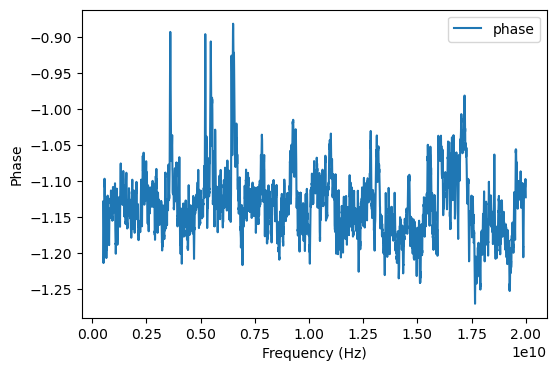

Resonance @ 4.133000 GHz, Q ≈ 153.1
Resonance @ 5.303000 GHz, Q ≈ 294.6
Resonance @ 5.789000 GHz, Q ≈ 275.7
Resonance @ 15.119000 GHz, Q ≈ 1259.9
Detected 4 phase spikes / resonances at power index 50.


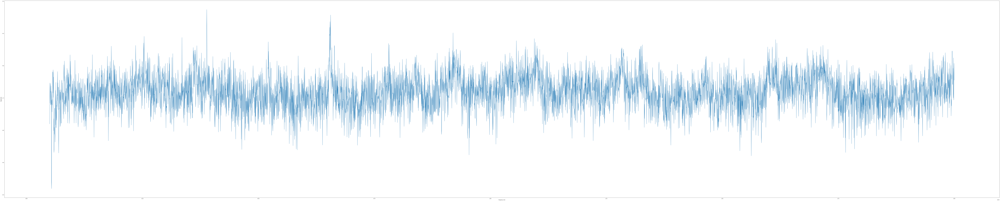

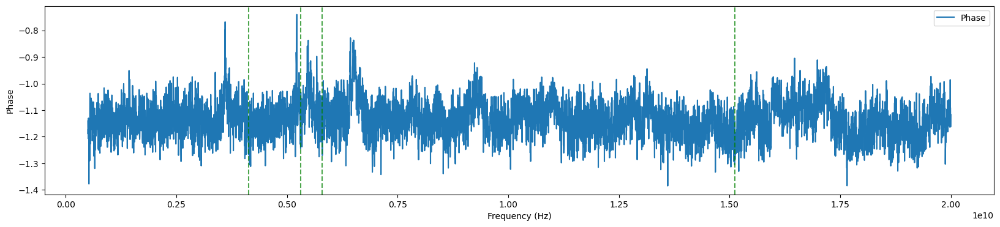

In [161]:

    power_index= 50 
    # Extract the single-power cut

    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)

    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence= 0.5, power_index=power_index, smooth_window=20, polyorder=3)
    
    
    # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=25e7)

    #remember the data 
    freq_res_12_50=freq_res
    
    #  Plot of the results
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res:
        plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

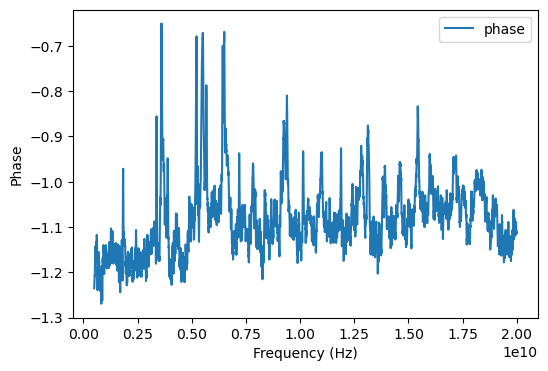

Resonance @ 2.003000 GHz, Q ≈ 83.5
Resonance @ 3.503000 GHz, Q ≈ 583.8
Resonance @ 4.073000 GHz, Q ≈ 150.9
Resonance @ 5.336000 GHz, Q ≈ 592.9
Resonance @ 5.780000 GHz, Q ≈ 963.3
Resonance @ 8.264000 GHz, Q ≈ 344.3
Resonance @ 9.884000 GHz, Q ≈ 658.9
Resonance @ 12.011000 GHz, Q ≈ 1000.9
Resonance @ 13.583000 GHz, Q ≈ 646.8
Detected 9 phase spikes / resonances at power index 80.


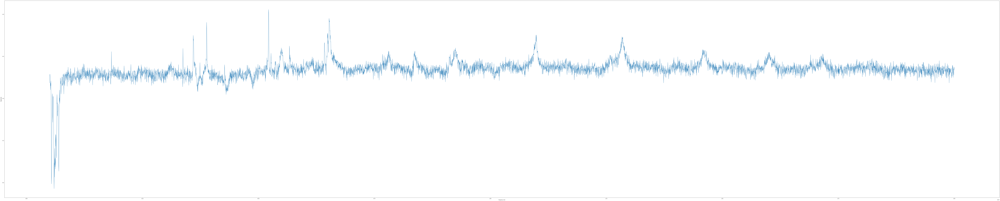

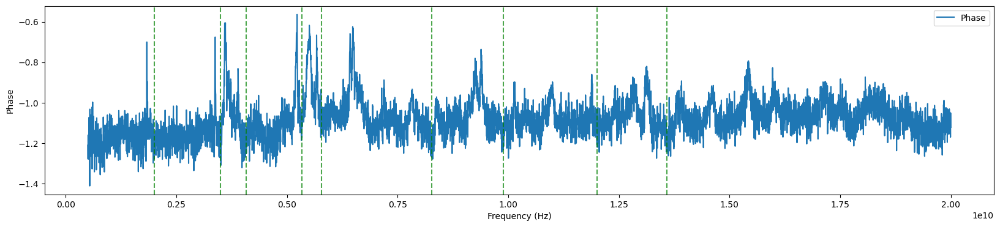

In [160]:

    power_index= 80 
    # Extract the single-power cut

    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)

    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence= 0.5, power_index=power_index,smooth_window=17, polyorder=3)
    
      
    # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=25e7)
    
      #remember the data 
    freq_res_12_80=freq_res
    
    #  Plot of the results
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res:
        plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

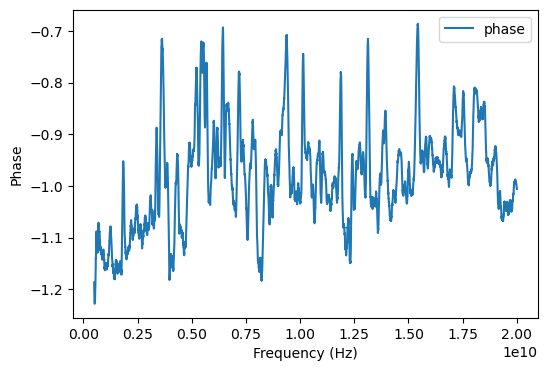

Resonance @ 3.974000 GHz, Q ≈ 147.2
Resonance @ 5.852000 GHz, Q ≈ 195.1
Resonance @ 8.225000 GHz, Q ≈ 304.6
Resonance @ 9.860000 GHz, Q ≈ 410.8
Resonance @ 10.664000 GHz, Q ≈ 507.8
Resonance @ 12.320000 GHz, Q ≈ 821.3
Resonance @ 13.589000 GHz, Q ≈ 566.2
Detected 8 phase spikes / resonances at power index 100.


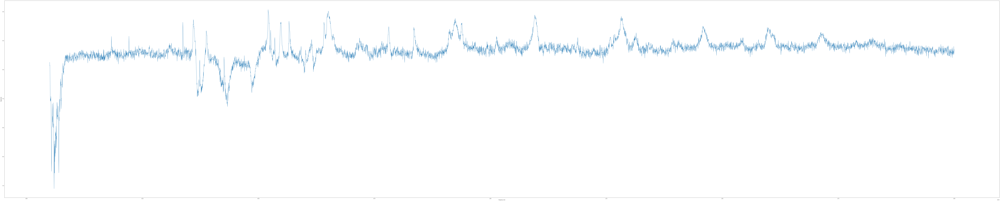

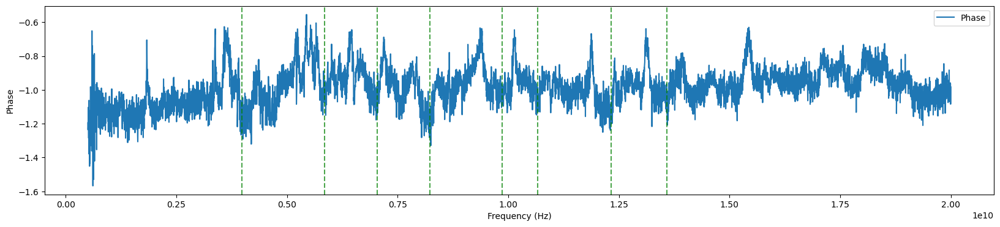

In [162]:

    power_index= 100
    # Extract the single-power cut

    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)

    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence= 0.5, power_index=power_index,smooth_window=50, polyorder=3)
    
      
    # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=20e7)
    
    #remember the data 
    freq_res_12_100=freq_res
    
    #  Plot of the results
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res:
        plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

I now examine the resonances of run 15 , I will save in variables the resonant frequencies for later evaluation and to summarize the results. 

In [141]:
# Replace with the actual run ID you want to load: I want to study run 12 and 15 
run_id = 15
dataset = load_by_run_spec(captured_run_id=run_id)
dataset

print("\n")

data = dataset.get_parameter_data()

# Print all the available parameter names and their shapes
for group, params in data.items():
    print(f"\nGroup: {group}")
    for param, values in params.items():
        print(f" - {param}: shape {np.shape(values)}")




Group: S21_mag
 - S21_mag: shape (101, 6501)
 - RS_SMB100_power: shape (101, 6501)
 - RS_SMB100_frequency: shape (101, 6501)

Group: S21_phase
 - S21_phase: shape (101, 6501)
 - RS_SMB100_power: shape (101, 6501)
 - RS_SMB100_frequency: shape (101, 6501)


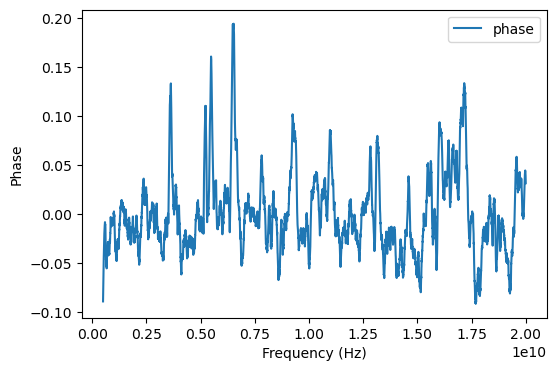

Resonance @ 3.629000 GHz, Q ≈ 172.8
Resonance @ 5.225000 GHz, Q ≈ 435.4
Resonance @ 5.483000 GHz, Q ≈ 228.5
Resonance @ 6.524000 GHz, Q ≈ 217.5
Resonance @ 17.162000 GHz, Q ≈ 715.1
Detected 6 phase spikes / resonances at power index 50.


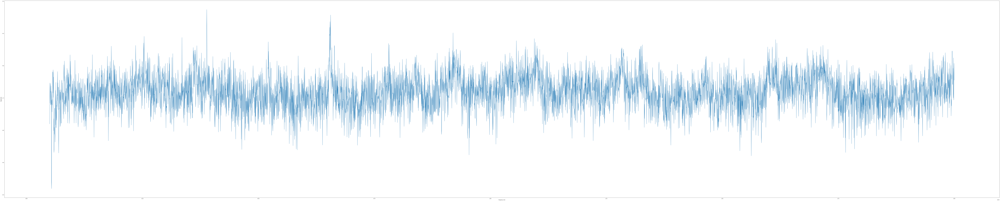

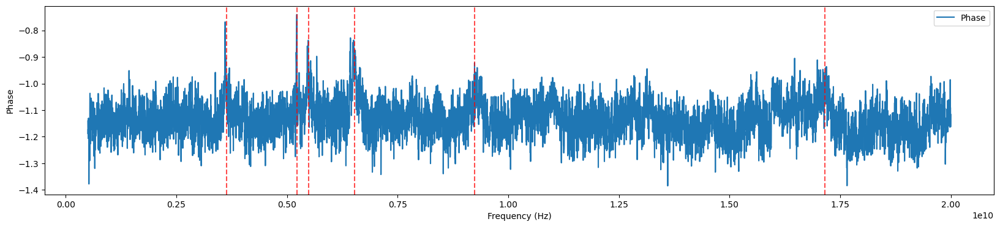

In [142]:
    
    power_index = 50 
    
    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)

    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence=0.010, power_index=power_index,smooth_window=60, polyorder=3)

     # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=20e7)
    
    
    #remember the data 
    freq_res_15_50=freq_res
    
    #  Plot of the results
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res:
        plt.axvline(x=fr, color='red', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

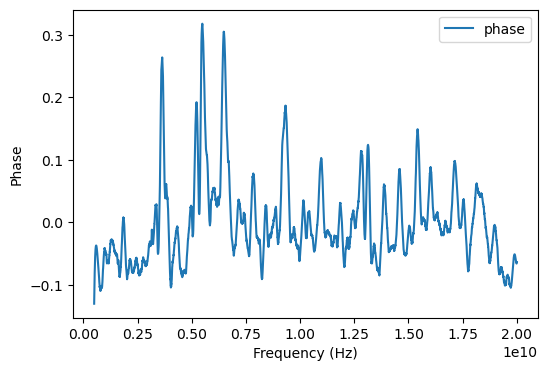

Resonance @ 3.638000 GHz, Q ≈ 606.3
Resonance @ 5.222000 GHz, Q ≈ 193.4
Resonance @ 5.489000 GHz, Q ≈ 1829.7
Resonance @ 6.479000 GHz, Q ≈ 359.9
Resonance @ 9.326000 GHz, Q ≈ 310.9
Resonance @ 12.833000 GHz, Q ≈ 2138.8
Resonance @ 13.133000 GHz, Q ≈ 437.8
Resonance @ 15.419000 GHz, Q ≈ 1027.9
Detected 8 phase spikes / resonances at power index 80.


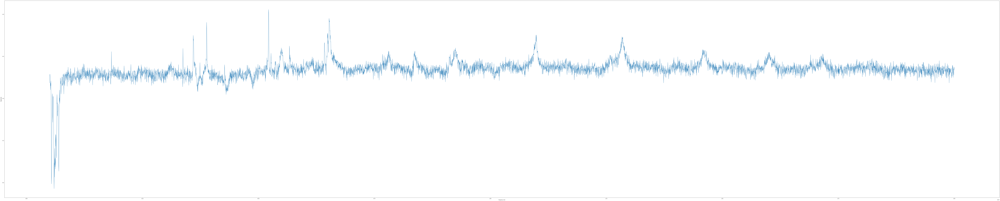

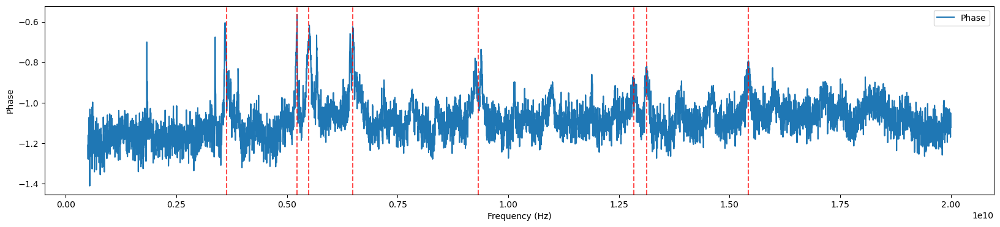

In [143]:

    power_index = 80 
    
    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)

    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence=0.012, power_index=power_index,smooth_window=150, polyorder=5)

      # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=20e7)
    
    #remember the data 
    freq_res_15_80=freq_res
    #  Plot of the results
    
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res:
        plt.axvline(x=fr, color='red', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

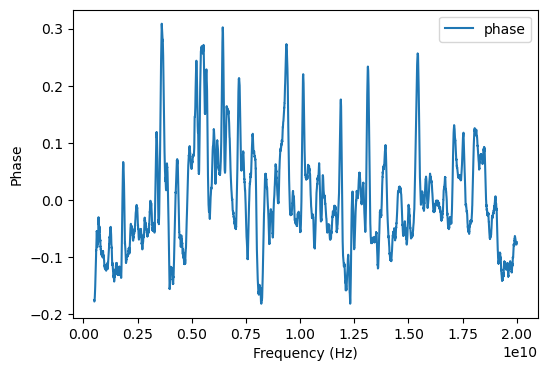

Resonance @ 3.617000 GHz, Q ≈ 150.7
Resonance @ 5.216000 GHz, Q ≈ 248.4
Resonance @ 5.546000 GHz, Q ≈ 205.4
Resonance @ 6.431000 GHz, Q ≈ 428.7
Resonance @ 7.187000 GHz, Q ≈ 299.5
Resonance @ 9.368000 GHz, Q ≈ 624.5
Resonance @ 10.142000 GHz, Q ≈ 483.0
Resonance @ 13.127000 GHz, Q ≈ 547.0
Resonance @ 15.422000 GHz, Q ≈ 2570.3
Detected 9 phase spikes / resonances at power index 100.


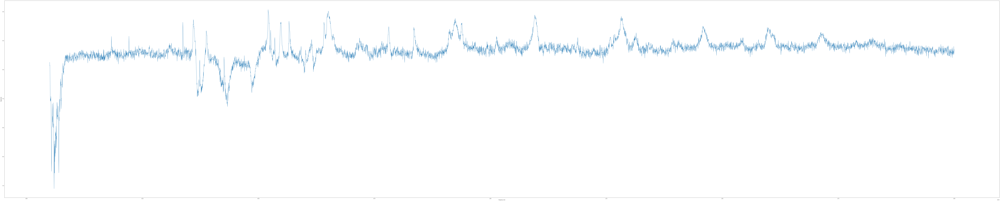

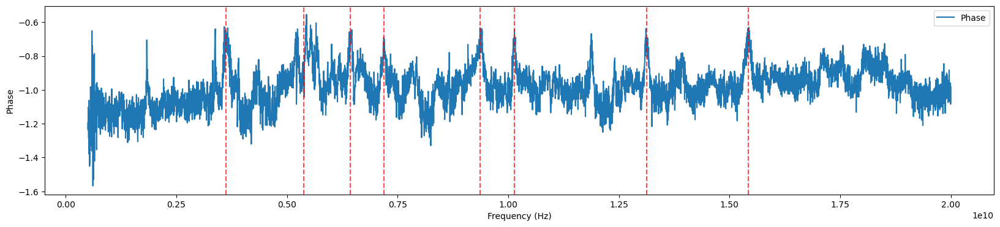

In [144]:

    power_index = 100 
    
    freq_trace  = data['S21_mag']['RS_SMB100_frequency'][power_index]
    mag_trace   = data['S21_mag']['S21_mag'][power_index]
    phase_trace = data['S21_phase']['S21_phase'][power_index]
    phase_unwrapped= unph = np.unwrap(phase_trace)
    
    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence=0.04, power_index=power_index,smooth_window=60, polyorder=3)

      # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=40e7)
    
    #remember the data 
    freq_res_15_100 = freq_res
    
    #  Plot of the results
    plt.figure(figsize=(200, 40))
    plt.plot(freq_trace, mag_trace, label='Magnitude (dB)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.show()

    plt.figure(figsize=(20, 4))
    plt.plot(freq_trace, phase_unwrapped, label='Phase')
    for fr in freq_res_15_100:
        plt.axvline(x=fr, color='red', linestyle='--', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()

Now, for the 3 selected power indexes , we are going to plot the resonance lines of the 2 runs on the whole spectrum profile 

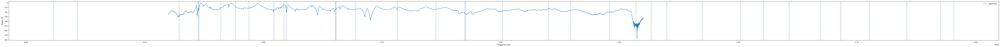

In [145]:
# Power index 50 

plt.figure(figsize=(100, 4))
plt.plot(freq_rear, mag_rear, label='Spectrum')
for fr in freq_res_15_50:
    plt.axvline(x=fr, color='blue', linestyle='--', alpha=0.7)
for fr in freq_res_12_50:
    plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Phase_50')
plt.legend()
plt.show()

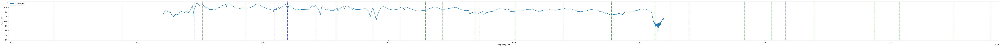

In [146]:
# Power index 80 

plt.figure(figsize=(100, 4))
plt.plot(freq_rear, mag_rear, label='Spectrum')
for fr in freq_res_15_80:
    plt.axvline(x=fr, color='blue', linestyle='--', alpha=0.7)
for fr in freq_res_12_80:
    plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Phase_80')
plt.legend()
plt.show()

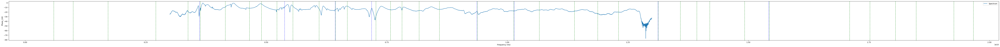

In [147]:
# Power index 100 

plt.figure(figsize=(100, 4))
plt.plot(freq_rear, mag_rear, label='Spectrum')
for fr in freq_res_15_100:
    plt.axvline(x=fr, color='blue', linestyle='--', alpha=0.7)
for fr in freq_res_12_100:
    plt.axvline(x=fr, color='green', linestyle='--', alpha=0.7)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Phase_100')
plt.legend()
plt.show()

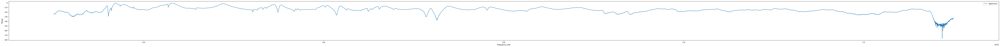

In [148]:

plt.figure(figsize=(100, 4))
plt.plot(freq_rear, mag_rear, label='Spectrum')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Phase')
plt.legend()
plt.show()

Since some problems always emerge at high frequency we create fake data and use the function on it to see if the function works well. 

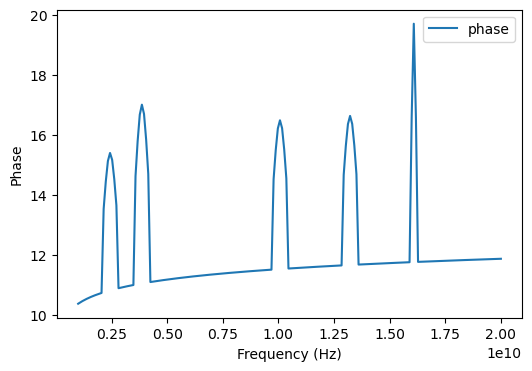

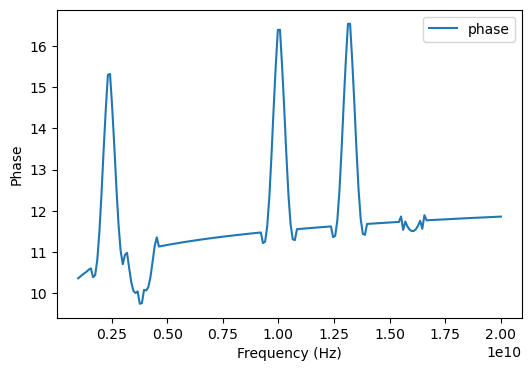

Resonance @ 2.432161 GHz, Q ≈ 3.2
Resonance @ 3.195980 GHz, Q ≈ 3.3
Resonance @ 3.673367 GHz, Q ≈ 5.5
Resonance @ 3.959799 GHz, Q ≈ 5.2
Resonance @ 4.532663 GHz, Q ≈ 23.7
Resonance @ 10.070352 GHz, Q ≈ 13.2
Resonance @ 13.221106 GHz, Q ≈ 17.3
Resonance @ 15.512563 GHz, Q ≈ 162.5
Resonance @ 15.703518 GHz, Q ≈ 54.8
Resonance @ 16.371859 GHz, Q ≈ 42.9
Resonance @ 16.562814 GHz, Q ≈ 173.5
Detected 14 phase spikes / resonances at power index 100.


In [167]:
    # ---- Load data -----------------------------------------------------------
    freq_trace = np.load(r"C:\Users\Nicola\Documents\CdL_Fisica\INTERNSHIP\FBK_superconducting_circuits\23_05\frequency_array.npy")      # frequency in Hz
    
    phase_trace = np.load(r"C:\Users\Nicola\Documents\CdL_Fisica\INTERNSHIP\FBK_superconducting_circuits\23_05\phase_array.npy")    # phase in radians
    
    #Plot Fake data 
    plt.figure(figsize=(6, 4))
    plt.plot(freq_trace, phase_trace, label='phase')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.legend()
    plt.show()
    
    
    # Detect resonances
    indices, freq_res=detect_phase_spikes(freq_trace, phase_trace, prominence=0.2, power_index=power_index,smooth_window=10, polyorder=3)

      # Avoid spurious clustering of resonances
    freq_res = cluster_spikes(freq_res, spacing_threshold=40e7)
    
    



It is clear, from this experiment with fake data, that the Savitzky Golay algorythm, if we are not in the presence of great noise, may do more harm than good. 

So, as for the results of my analysis,  refer to the script Resonance_Study_Display which is not just simpler but also works better.

It may be the case to consider this script only for the power index 100 run 15 , where greater noise is present. 